In [ ]:
!pip install shap
!pip install lime
!pip install transformers

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 547.9/547.9 kB 7.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 4.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283835 sha256=1d0a3ba4a82563217d91a398b81308fcd62c13ed5a6bc87c6ea61603618c3207
  Stored in directory: /root/.cache/pip/wheels/fd/a2/af/9ac0a1a85a27f314a06b39e1f492bee1547d52549a4606ed89
Successfully built lime
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.4/7.4 MB 26.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 268.8/268.8 kB 25.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 47.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 55.8 MB/s eta 0:00:00


In [ ]:
import shap
import pickle
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.naive_bayes import MultinomialNB, GaussianNB, CategoricalNB
from sklearn.metrics import accuracy_score
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV
from sklearn.preprocessing import OneHotEncoder, LabelEncoder
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.ensemble import RandomForestClassifier

# LIME packages
from lime import lime_text
from lime.lime_text import LimeTextExplainer
from sklearn.pipeline import make_pipeline
from lime.lime_text import IndexedString,IndexedCharacters
from lime.lime_base import LimeBase
from sklearn.linear_model import Ridge, lars_path
from lime.lime_text import explanation
from functools import partial
import scipy as sp
from sklearn.utils import check_random_state
from sklearn.metrics import classification_report, confusion_matrix

from transformers import AutoTokenizer, TFAutoModel
import tensorflow as tf
from tqdm import tqdm

In [ ]:
!pip install gdown

In [ ]:
'''
https://drive.google.com/file/d/1Fs0PTy_xPsoX5bg4QTCrX6JAaQCHRzis/view?usp=drive_link
https://drive.google.com/file/d/1JLa-ELhUskQINi0syf3YJWBX8jcCXdn4/view?usp=drive_link
'''

'\nhttps://drive.google.com/file/d/1Fs0PTy_xPsoX5bg4QTCrX6JAaQCHRzis/view?usp=drive_link\nhttps://drive.google.com/file/d/1JLa-ELhUskQINi0syf3YJWBX8jcCXdn4/view?usp=drive_link\n'

In [ ]:
!gdown 1Fs0PTy_xPsoX5bg4QTCrX6JAaQCHRzis
!gdown 1JLa-ELhUskQINi0syf3YJWBX8jcCXdn4

Downloading...
From: https://drive.google.com/uc?id=1Fs0PTy_xPsoX5bg4QTCrX6JAaQCHRzis
To: /content/train.pkl
100% 4.09M/4.09M [00:00<00:00, 274MB/s]
Downloading...
From: https://drive.google.com/uc?id=1JLa-ELhUskQINi0syf3YJWBX8jcCXdn4
To: /content/test.pkl
100% 1.01M/1.01M [00:00<00:00, 77.2MB/s]


In [ ]:
FILE_PATH = "train.pkl"

with open(FILE_PATH, 'rb') as f:
    df_train = pickle.load(f)

In [ ]:
FILE_PATH = "test.pkl"

with open(FILE_PATH, 'rb') as f:
    df_test = pickle.load(f)

In [ ]:
df_train.reset_index(drop = True, inplace = True)
df_test.reset_index(drop = True, inplace = True)

In [ ]:
df_train.head()

,tweet,label,tweet_with_out_emojis,cleaned_data,Light Stemming,Root Stemming
0,شايف نفسه الحمار مع انه كان احتياط الموسم الما...,1,شايف نفسه الحمار مع انه كان احتياط الموسم الما...,شايف الحمار انه احتياط الموسم الماضي اليوفي اد...,شايف الحمار انه احتياط الموسم الماضي اليوفي اد...,شيف حمر انه حيط وسم اضي يوف دره ريل امر غرب هج...
1,: هزق البلد كلها ..مرتضي محدش عارف يوقفه ..ل...,1,: هزق البلد كلها ..مرتضي محدش عارف يوقفه ..ل...,هزق البلد مرتضي محدش عارف يوقفه لا وزير داخليه...,هزق البلد مرتضي محدش عارف يوقفه لا وزير داخليه...,هزق بلد رضي حدش عرف وقف لا وزر دخل شبب حتي بتع...
2,استفتاء : عندما تنتهي الاوليمبياد وتعود بعثتنا...,0,استفتاء : عندما تنتهي الاوليمبياد وتعود بعثتنا...,استفتاء تنتهي الاوليمبياد وتعود بعثتنا بالسلام...,استفتاء تنتهي الاوليمبياد وتعود بعثت بالسلامه ...,فاء نهي اوليمبياد تعد بعث سلم يدل حصل وجه نظر
3,Alhashemلا يوجد مخرج لنفط داعش سوي تركيا.هكذا ...,1,Alhashemلا يوجد مخرج لنفط داعش سوي تركيا.هكذا ...,لا يوجد مخرج لنفط داعش سوي تركياهكذا تقول الجغ...,لا يوجد مخرج لنفط داعش سوي تركياهكذا تقول الجغ...,لا وجد خرج نفط دعش سوي تركياهكذا تقل جغراف سؤل...
4,ما احب اركب جاهل معاي السياره عادي اتوتر طول م...,7,ما احب اركب جاهل معاي السياره عادي اتوتر طول م...,احب اركب جاهل معاي السياره عادي اتوتر طول اسوق...,احب اركب جاهل معاي السياره عادي اتوتر طول اسوق...,احب ركب جهل عاي سير عدي وتر طول اسق خيف فرح


In [ ]:
marbert_model_path = 'UBC-NLP/MARBERT'
tokenizer = AutoTokenizer.from_pretrained(marbert_model_path, from_tf=True)
marbert_model = TFAutoModel.from_pretrained(marbert_model_path, output_hidden_states=True)

All model checkpoint layers were used when initializing TFBertModel.

All the layers of TFBertModel were initialized from the model checkpoint at UBC-NLP/MARBERT.
If your task is similar to the task the model of the checkpoint was trained on, you can already use TFBertModel for predictions without further training.


In [ ]:
remove_special_tokens=1  #change this to 0 if you want to keep the special token
stemtype = 'tweet'

In [ ]:
def bert_tokenize(text: str) -> dict:
  tokens = tokenizer(text, padding='max_length', truncation=True, max_length=50)
  if remove_special_tokens == 1:
    shape = np.array(tokens['input_ids']).shape
    modified_input_ids = np.zeros(shape).astype(np.int32)
    modified_attention_mask = np.zeros(shape).astype(np.int32)
    # Modify the input IDs and attention mask as per your requirement
    for i in range(shape[0]):
      modified_input_ids[i] = [0 if token_id == 1 else 0 if token_id == 3 else 0 if token_id == 0 else 0 if token_id == 2 else 0 if token_id == 4 else token_id for token_id in tokens['input_ids'][i]]
      modified_attention_mask[i] = [0 if token_id in [1, 3, 0, 2, 4] else 1 for token_id in tokens['input_ids'][i]]
    # Update the input IDs and attention mask in the tokens dictionary
    tokens['input_ids'] = modified_input_ids
    tokens['attention_mask'] = modified_attention_mask
  return tokens

In [ ]:
def get_embeddings(ids, mask, type_ids):
  ids = tf.convert_to_tensor(ids)
  #print(ids.shape)
  mask = tf.convert_to_tensor(mask)
  #print(mask.shape)
  #print(mask)
  type_ids = tf.convert_to_tensor(type_ids)
  #print(type_ids.shape)
  hidden_states = marbert_model(input_ids=ids, attention_mask=mask, token_type_ids=type_ids)[0]
  averaged_embedding = tf.reduce_mean(hidden_states, axis=1)
  return averaged_embedding.numpy()

In [ ]:
label_to_class = [
    'none',
    'anger',
    'joy',
    'sadness',
    'love',
    'sympathy',
    'surprise',
    'fear'
]

In [ ]:
def map_label_to_class(indices, classes):
  return [classes[idx] for idx in indices]

In [ ]:
map_label_to_class([0, 1, 2, 3, 4, 5, 6, 7, 0, 6], label_to_class)

['none',
 'anger',
 'joy',
 'sadness',
 'love',
 'sympathy',
 'surprise',
 'fear',
 'none',
 'surprise']

In [ ]:
def create_confusion_matrix(y_pred):
  # creatin a confusion matrix
  y_true = map_label_to_class(df_test['label'], label_to_class)
  y_pred = map_label_to_class(y_pred, label_to_class)
  cm = confusion_matrix(y_true, y_pred, labels=label_to_class)
  # create a DataFrame for the confusion matrix with class names as index and columns
  cm_df = pd.DataFrame(cm, index=label_to_class, columns=label_to_class)

  # create a heatmap for visualization
  plt.figure(figsize=(5, 5))
  sns.heatmap(cm_df, annot=True, cmap='Blues', fmt='g')
  plt.xlabel('Predicted')
  plt.ylabel('True')
  plt.title('Confusion Matrix')
  plt.show()

In [ ]:
x_train = df_train[stemtype].values.astype(str).tolist()
x_train = bert_tokenize(x_train)

#x_train = get_embeddings(x_train)
#emb = emb.reshape(1, -1)
xlen = np.array(x_train['input_ids']).shape[0]

In [ ]:
xlen

8052

In [ ]:
x_train_emb = np.zeros((xlen,768))
for i in range(0,xlen,100):
    if(i+100 < xlen):
        input_ids = x_train['input_ids'][i:i+100]
        attention_mask = x_train['attention_mask'][i:i+100]
        token_type_ids = x_train['token_type_ids'][i:i+100]
        x_train_emb[i:i+100] = get_embeddings(input_ids,attention_mask,token_type_ids)
    else:
        input_ids = x_train['input_ids'][i:xlen]
        attention_mask = x_train['attention_mask'][i:xlen]
        token_type_ids = x_train['token_type_ids'][i:xlen]
        x_train_emb[i:xlen] = get_embeddings(input_ids,attention_mask,token_type_ids)

In [ ]:
x_train_emb.shape

(8052, 768)

In [ ]:
x_test = df_test[stemtype].values.astype(str).tolist()
x_test = bert_tokenize(x_test)

#x_train = get_embeddings(x_train)
#emb = emb.reshape(1, -1)
xlen = np.array(x_test['input_ids']).shape[0]

In [ ]:
xlen

2013

In [ ]:
x_test_emb = np.zeros((xlen,768))
for i in range(0,xlen,100):
    if(i+100 < xlen):
        input_ids = x_test['input_ids'][i:i+100]
        attention_mask = x_test['attention_mask'][i:i+100]
        token_type_ids = x_test['token_type_ids'][i:i+100]
        x_test_emb[i:i+100] = get_embeddings(input_ids,attention_mask,token_type_ids)
    else:
        input_ids = x_test['input_ids'][i:xlen]
        attention_mask = x_test['attention_mask'][i:xlen]
        token_type_ids = x_test['token_type_ids'][i:xlen]
        x_test_emb[i:xlen] = get_embeddings(input_ids,attention_mask,token_type_ids)

In [ ]:
x_test_emb.shape

(2013, 768)

## Naive Bayes Model

In [ ]:
# use Tfidf Vectorizer root stemming
tfidf_vectorizer_rs = TfidfVectorizer()
# fit and transform the training data
X_train_tfidf_rs = tfidf_vectorizer_rs.fit_transform(df_train['Root Stemming'])
# transform the test data using the same vectorizer
X_test_tfidf_rs = tfidf_vectorizer_rs.transform(df_test['Root Stemming'])

# use Tfidf Vectorizer light stemming
tfidf_vectorizer_ls = TfidfVectorizer()
# fit and transform the training data
X_train_tfidf_ls = tfidf_vectorizer_ls.fit_transform(df_train['Light Stemming'])
# transform the test data using the same vectorizer
X_test_tfidf_ls = tfidf_vectorizer_ls.transform(df_test['Light Stemming'])

# use Tfidf Vectorizer without any preprocessing
tfidf_vectorizer = TfidfVectorizer()
# fit and transform the training data
X_train_tfidf = tfidf_vectorizer.fit_transform(df_train['tweet'])
# transform the test data using the same vectorizer
X_test_tfidf = tfidf_vectorizer.transform(df_test['tweet'])

### Using CategoricalNB

In [ ]:
# without preprocessing
nb_vec = CategoricalNB()
nb_vec.fit(X_train_tfidf.toarray(), df_train['label'])

# train accuracy of tf-idf vectorizer
y_pred = nb_vec.predict(X_train_tfidf.toarray())
# calculating the accuracy of the classifier
accuracy = accuracy_score(df_train['label'], y_pred)
print("Accuracy:", accuracy)

Accuracy: 0.1587183308494784


### Using GaussianNB

In [ ]:
nb_vec = GaussianNB()
nb_vec.fit(X_train_tfidf.toarray(), df_train['label'])

# test accuracy of tf-idf vectorizer
y_pred = nb_vec.predict(X_test_tfidf.toarray())
# calculating the accuracy of the classifier
accuracy = accuracy_score(df_test['label'], y_pred)
print("Accuracy:", accuracy)

Accuracy: 0.43517138599105815


In [ ]:
print(classification_report(df_test['label'], y_pred, target_names = label_to_class))

              precision    recall  f1-score   support

        none       0.44      0.42      0.43       307
       anger       0.46      0.61      0.52       276
         joy       0.37      0.30      0.33       268
     sadness       0.27      0.24      0.26       258
        love       0.55      0.52      0.53       250
    sympathy       0.61      0.63      0.62       194
    surprise       0.25      0.26      0.25       201
        fear       0.50      0.51      0.50       259

    accuracy                           0.44      2013
   macro avg       0.43      0.44      0.43      2013
weighted avg       0.43      0.44      0.43      2013



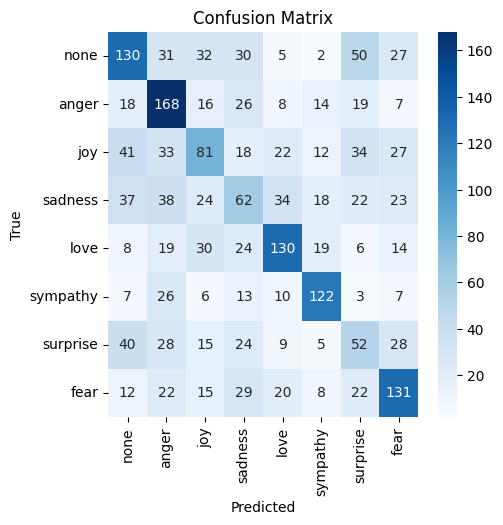

In [ ]:
create_confusion_matrix(y_pred)

In [ ]:
nb_vec = GaussianNB()
nb_vec.fit(X_train_tfidf_ls.toarray(), df_train['label'])

# test accuracy of tf-idf vectorizer
y_pred = nb_vec.predict(X_test_tfidf_ls.toarray())
# calculating the accuracy of the classifier
accuracy = accuracy_score(df_test['label'], y_pred)
print("Accuracy:", accuracy)

Accuracy: 0.42921013412816694


In [ ]:
print(classification_report(df_test['label'], y_pred, target_names = label_to_class))

              precision    recall  f1-score   support

        none       0.42      0.39      0.41       307
       anger       0.48      0.62      0.54       276
         joy       0.38      0.30      0.33       268
     sadness       0.27      0.24      0.26       258
        love       0.55      0.51      0.53       250
    sympathy       0.61      0.59      0.60       194
    surprise       0.27      0.27      0.27       201
        fear       0.44      0.52      0.48       259

    accuracy                           0.43      2013
   macro avg       0.43      0.43      0.43      2013
weighted avg       0.43      0.43      0.42      2013



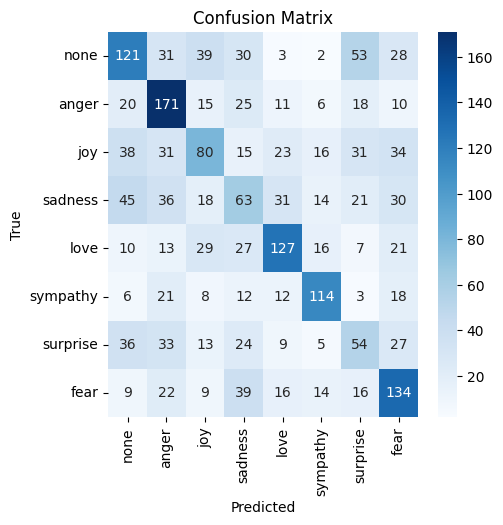

In [ ]:
create_confusion_matrix(y_pred)

### Using Embeddings

In [ ]:
nb_ls = GaussianNB()
nb_ls.fit(x_train_emb, df_train['label'])

# test accuracy of light stemming embeddings
y_pred = nb_ls.predict(x_test_emb)
# calculating the accuracy of the classifier
accuracy = accuracy_score(df_test['label'], y_pred)
print("Accuracy:", accuracy)

Accuracy: 0.4749130650769995


In [ ]:
print(classification_report(df_test['label'], y_pred, target_names = label_to_class))

              precision    recall  f1-score   support

        none       0.48      0.84      0.61       307
       anger       0.59      0.35      0.44       276
         joy       0.38      0.35      0.37       268
     sadness       0.35      0.21      0.26       258
        love       0.36      0.57      0.44       250
    sympathy       0.70      0.47      0.57       194
    surprise       0.35      0.37      0.36       201
        fear       0.87      0.55      0.67       259

    accuracy                           0.47      2013
   macro avg       0.51      0.47      0.47      2013
weighted avg       0.51      0.47      0.47      2013



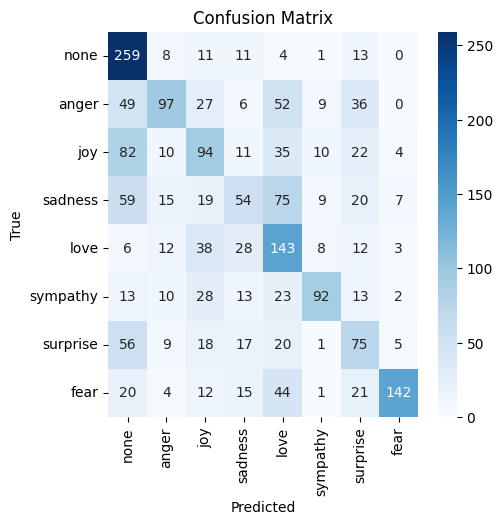

In [ ]:
create_confusion_matrix(y_pred)

### Random Forest

In [ ]:
rf_vec = RandomForestClassifier()
rf_vec.fit(X_train_tfidf, df_train['label'])

# test accuracy of tf-idf vectorizer
y_pred = rf_vec.predict(X_test_tfidf)
# calculating the accuracy of the classifier
accuracy = accuracy_score(df_test['label'], y_pred)
print("Accuracy:", accuracy)

Accuracy: 0.6035767511177347


In [ ]:
print(classification_report(df_test['label'], y_pred, target_names = label_to_class))

              precision    recall  f1-score   support

        none       0.56      0.95      0.71       307
       anger       0.67      0.52      0.58       276
         joy       0.50      0.29      0.36       268
     sadness       0.30      0.27      0.28       258
        love       0.61      0.62      0.61       250
    sympathy       0.77      0.84      0.80       194
    surprise       0.48      0.45      0.47       201
        fear       0.91      0.87      0.89       259

    accuracy                           0.60      2013
   macro avg       0.60      0.60      0.59      2013
weighted avg       0.60      0.60      0.59      2013



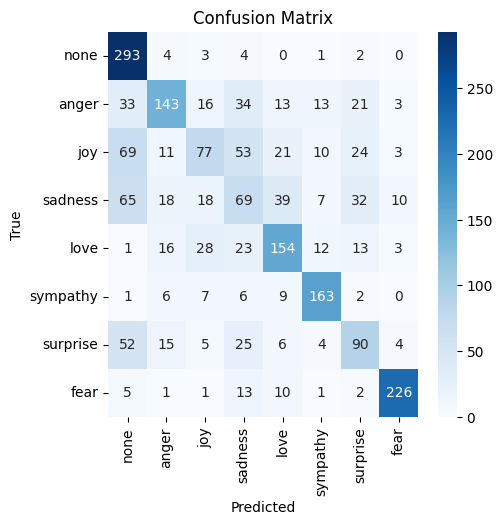

In [ ]:
create_confusion_matrix(y_pred)

## Using MultinomialNB

In [ ]:
nb_vec = MultinomialNB(force_alpha=True, alpha=0.1, fit_prior=True)
nb_vec.fit(X_train_tfidf, df_train['label'])

# test accuracy of tf-idf vectorizer
y_pred = nb_vec.predict(X_test_tfidf.toarray())
# calculating the accuracy of the classifier
accuracy = accuracy_score(df_test['label'], y_pred)
print("Accuracy:", accuracy)

Accuracy: 0.6005961251862891


In [ ]:
print(classification_report(df_test['label'], y_pred, target_names = label_to_class))

              precision    recall  f1-score   support

        none       0.49      0.81      0.61       307
       anger       0.61      0.67      0.64       276
         joy       0.56      0.37      0.45       268
     sadness       0.47      0.27      0.34       258
        love       0.62      0.71      0.66       250
    sympathy       0.76      0.81      0.79       194
    surprise       0.56      0.28      0.38       201
        fear       0.76      0.82      0.79       259

    accuracy                           0.60      2013
   macro avg       0.60      0.59      0.58      2013
weighted avg       0.60      0.60      0.58      2013



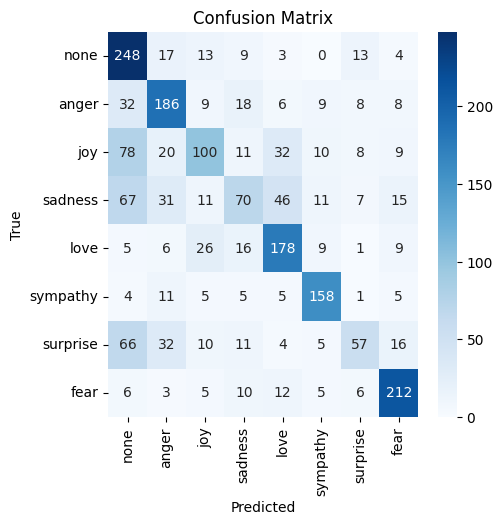

In [ ]:
create_confusion_matrix(y_pred)

In [ ]:
nb_vec = MultinomialNB(force_alpha=True, alpha=0.1, fit_prior=True)
nb_vec.fit(X_train_tfidf, df_train['label'])

# test accuracy of tf-idf vectorizer
y_pred = nb_vec.predict(X_test_tfidf.toarray())
# calculating the accuracy of the classifier
accuracy = accuracy_score(df_test['label'], y_pred)
print("Accuracy:", accuracy)

Accuracy: 0.6005961251862891


In [ ]:
print(classification_report(df_test['label'], y_pred, target_names = label_to_class))

              precision    recall  f1-score   support

        none       0.49      0.81      0.61       307
       anger       0.61      0.67      0.64       276
         joy       0.56      0.37      0.45       268
     sadness       0.47      0.27      0.34       258
        love       0.62      0.71      0.66       250
    sympathy       0.76      0.81      0.79       194
    surprise       0.56      0.28      0.38       201
        fear       0.76      0.82      0.79       259

    accuracy                           0.60      2013
   macro avg       0.60      0.59      0.58      2013
weighted avg       0.60      0.60      0.58      2013



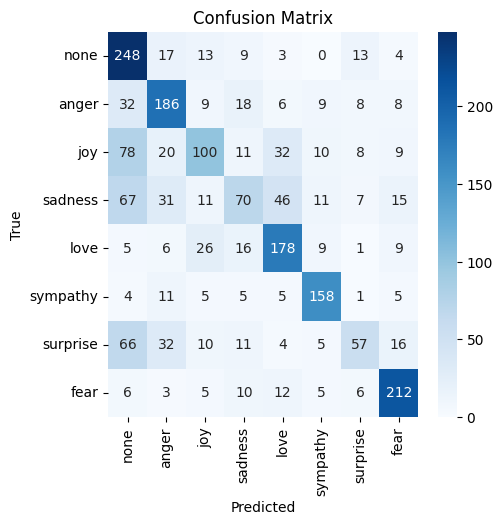

In [ ]:
create_confusion_matrix(y_pred)

## LIME

In [ ]:
def model_predict(text):
    vec = tfidf_vectorizer.transform(text)
    return nb_vec.predict_proba(vec)

## SHAP

In [ ]:
def shap_model_predict(text):
  text = text.astype(str).tolist()
  tokens = bert_tokenize(text)
  xlen = np.array(tokens['input_ids']).shape[0]
  x_emb = np.zeros((xlen,768))
  for i in range(0,xlen,100):
    if(i+100 < xlen):
        input_ids = tokens['input_ids'][i:i+100]
        attention_mask = tokens['attention_mask'][i:i+100]
        token_type_ids = tokens['token_type_ids'][i:i+100]
        x_emb[i:i+100] = get_embeddings(input_ids,attention_mask,token_type_ids)
    else:
        input_ids = tokens['input_ids'][i:xlen]
        attention_mask = tokens['attention_mask'][i:xlen]
        token_type_ids = tokens['token_type_ids'][i:xlen]
        x_emb[i:xlen] = get_embeddings(input_ids,attention_mask,token_type_ids)
  return nb_ls.predict_proba(x_emb)

In [ ]:
'''
function that initializes shap with the appropriate model
parameters
model: an instance of your model, ex: LogisticRegression instance
'''
def initializeShap(model):
  # split input text into tokens
  masker = shap.maskers.Text(tokenizer=r"\W+")
  if isinstance(model, LogisticRegression):
    explainer = shap.Explainer(model_predict, masker=masker, output_names=label_to_class)
  elif isinstance(model, MultinomialNB):
    explainer = shap.Explainer(model_predict, masker=masker, output_names=label_to_class)
  else: print("Please use a valid model !")
  return explainer

In [ ]:
nb_explainer = initializeShap(model=nb_vec)

## Exploration

In [ ]:
tp = df_test['label'] != y_pred

In [ ]:
tp = ((df_test['label'] == 7)*tp)

In [ ]:
tp[tp == True]

37      True
38      True
45      True
61      True
88      True
103     True
108     True
166     True
200     True
326     True
352     True
373     True
397     True
630     True
664     True
680     True
683     True
727     True
827     True
839     True
850     True
928     True
940     True
952     True
1001    True
1097    True
1101    True
1151    True
1197    True
1238    True
1313    True
1355    True
1380    True
1461    True
1478    True
1485    True
1526    True
1587    True
1738    True
1744    True
1778    True
1804    True
1818    True
1844    True
1935    True
1939    True
1980    True
Name: label, dtype: bool

In [ ]:
label_to_class

['none', 'anger', 'joy', 'sadness', 'love', 'sympathy', 'surprise', 'fear']

In [ ]:
def explain_example_lime(i):
    instance = df_test[stemtype].iloc[i]
    print("True label: ", label_to_class[df_test['label'].iloc[i]])
    print("Original tweet: ", df_test['tweet'].iloc[i])
    # creating a LimeTextExplainer
    explainer = LimeTextExplainer(class_names=label_to_class)

    # explaining the prediction
    explanation = explainer.explain_instance(instance, model_predict, num_features=10, labels = range(8))

    # showing the explanation
    explanation.show_in_notebook()

In [ ]:
def explain_example_shap(i):
    instance = df_test[stemtype].iloc[i:i+1].values.astype(str).tolist()
    print("True label: ", label_to_class[df_test['label'].iloc[i]])
    print("Original tweet: ", df_test['tweet'].iloc[i])
    shap_values = nb_explainer(instance)
    shap.text_plot(shap_values)

## Label None predicted correctly

In [ ]:
explain_example_lime(2)

True label:  none
Original tweet:  ملخص الاوليمبياد: • كان التوانسه تلاهاو باي واحد، مشي فيها • كان متبعوش و مسمعوش بيه عنده فرصه كبيره في ميداليه


In [ ]:
explain_example_shap(2)

True label:  none
Original tweet:  ملخص الاوليمبياد: • كان التوانسه تلاهاو باي واحد، مشي فيها • كان متبعوش و مسمعوش بيه عنده فرصه كبيره في ميداليه


## Label None predicted incorrectly

In [ ]:
explain_example_lime(244)

True label:  none
Original tweet:  مش باقولك يجندوا الشعب يمكن يتعدل حاله الاوليمبياد منكده علينا


In [ ]:
explain_example_shap(244)

True label:  none
Original tweet:  مش باقولك يجندوا الشعب يمكن يتعدل حاله الاوليمبياد منكده علينا


## Label Anger predicted correctly

In [ ]:
explain_example_lime(31)

True label:  anger
Original tweet:  iil لا راح تخليني اجاوز عليك يا وجه البعير خره عليك وعلي سلمان وعلي ابوك وابو سلمان يا عاهره


In [ ]:
explain_example_shap(31)

True label:  anger
Original tweet:  iil لا راح تخليني اجاوز عليك يا وجه البعير خره عليك وعلي سلمان وعلي ابوك وابو سلمان يا عاهره


## Label Anger predicted incorrectly

In [ ]:
explain_example_lime(49)

True label:  anger
Original tweet:  .   يقول الفيلسوف ميشال سير في مقال بمجله لوبوان “ تَقضي امراه كل يوم نحبها في فرنسا تحت ضربات رفيقها، او زوجها او عشيقها “


In [ ]:
explain_example_shap(49)

True label:  anger
Original tweet:  .   يقول الفيلسوف ميشال سير في مقال بمجله لوبوان “ تَقضي امراه كل يوم نحبها في فرنسا تحت ضربات رفيقها، او زوجها او عشيقها “


## Label Joy predicted correctly

In [ ]:
explain_example_lime(3)

True label:  joy
Original tweet:  دايما معاه و روحنا فداه.


In [ ]:
explain_example_shap(3)

True label:  joy
Original tweet:  دايما معاه و روحنا فداه.


## Label Joy predicted incorrectly

In [ ]:
explain_example_lime(21)

True label:  joy
Original tweet:  ضحكتها بس لوحدها قصيــده شعــر


In [ ]:
explain_example_shap(21)

True label:  joy
Original tweet:  ضحكتها بس لوحدها قصيــده شعــر


## Label Sadness predicted correctly

In [ ]:
explain_example_lime(65)

True label:  sadness
Original tweet:  اسمط شعور ... تقعد مضايق و تفتح الكاميرا الاماميه بالغلط.. يعني هو الواحد ناقصه هموم.


In [ ]:
explain_example_shap(65)

True label:  sadness
Original tweet:  اسمط شعور ... تقعد مضايق و تفتح الكاميرا الاماميه بالغلط.. يعني هو الواحد ناقصه هموم.


## Label Sadness predicted incorrectly

In [ ]:
explain_example_lime(12)

True label:  sadness
Original tweet:  ذهبت لكي اخبره باشتياقي .. فاصدمت .. فقد ذهب لمن خلقه ..


In [ ]:
explain_example_shap(12)

True label:  sadness
Original tweet:  ذهبت لكي اخبره باشتياقي .. فاصدمت .. فقد ذهب لمن خلقه ..


## Label Love predicted correctly

In [ ]:
explain_example_lime(0)

True label:  love
Original tweet:  rm: اينما وليت وجهك : ستجدني ؛ انا داخلك..!  غَــرام


In [ ]:
explain_example_shap(0)

True label:  love
Original tweet:  rm: اينما وليت وجهك : ستجدني ؛ انا داخلك..!  غَــرام


## Label Love predicted incorrectly

In [ ]:
explain_example_lime(10)

True label:  love
Original tweet:  ايمن حفني: اصل محمد صلاح دا بالنسبالي ترامادول???????? لما بيبقي مدير فني ببقي فشيخ  باصي لعفيفي


In [ ]:
explain_example_shap(10)

True label:  love
Original tweet:  ايمن حفني: اصل محمد صلاح دا بالنسبالي ترامادول???????? لما بيبقي مدير فني ببقي فشيخ  باصي لعفيفي


## Label Sympathy predicted correctly

In [ ]:
explain_example_lime(4)

True label:  sympathy
Original tweet:  الدعاء لاهلنا ب  حلب فهم بحاجه له فهم يتعرضون لقصف شرس نسال الله ان يحفظهم فهناك العشرات من الشهداء والجرحي اسال الله ان يتقبلهم ويشافيهم


In [ ]:
explain_example_shap(4)

True label:  sympathy
Original tweet:  الدعاء لاهلنا ب  حلب فهم بحاجه له فهم يتعرضون لقصف شرس نسال الله ان يحفظهم فهناك العشرات من الشهداء والجرحي اسال الله ان يتقبلهم ويشافيهم


## Label Sympathy predicted incorrectly

In [ ]:
explain_example_lime(98)

True label:  sympathy
Original tweet:  استاذ ناصر تحياتي الطيبه لك  لا يصح لمن هو في مثل مكانتك ان يتبني مثل هذا الفكر يكفيك منه ان (تُسب او والديك) من شخص جاهل متعصب


In [ ]:
explain_example_shap(98)

True label:  sympathy
Original tweet:  استاذ ناصر تحياتي الطيبه لك  لا يصح لمن هو في مثل مكانتك ان يتبني مثل هذا الفكر يكفيك منه ان (تُسب او والديك) من شخص جاهل متعصب


## Label Surprise predicted correctly

In [ ]:
explain_example_lime(48)

True label:  surprise
Original tweet:  مَش معقول الساعه لِسَّه 8 الا عشره ؟


In [ ]:
explain_example_shap(48)

True label:  surprise
Original tweet:  مَش معقول الساعه لِسَّه 8 الا عشره ؟


## Label Surprise explained incorrectly

In [ ]:
explain_example_lime(23)

True label:  surprise
Original tweet:  ايه ده انا مافهمتش ليه نازله بعلم الاوليمبياد عشان مالها بلدها بقي؟؟


In [ ]:
explain_example_shap(23)

True label:  surprise
Original tweet:  ايه ده انا مافهمتش ليه نازله بعلم الاوليمبياد عشان مالها بلدها بقي؟؟


## Label Fear predicted correctly

In [ ]:
explain_example_lime(1)

True label:  fear
Original tweet:  : انا خايف يطلع القدر بالشحته وضاحكين عليا


In [ ]:
explain_example_shap(1)

True label:  fear
Original tweet:  : انا خايف يطلع القدر بالشحته وضاحكين عليا


## Label Fear predicted correctly

In [ ]:
explain_example_lime(38)

True label:  fear
Original tweet:  شيء مخيف ومرعب! بعد حب وصلح بين النفس والذات مع الطرف الاخر. ياتي ذاك الشعور البارد والقنوع مع من تحب.


In [ ]:
explain_example_shap(38)

True label:  fear
Original tweet:  شيء مخيف ومرعب! بعد حب وصلح بين النفس والذات مع الطرف الاخر. ياتي ذاك الشعور البارد والقنوع مع من تحب.


In [ ]:
++